In [7]:
import pandas as pd
import numpy as np
import itertools

import plotly.express as px
import plotly.subplots as sp

import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from mpl_toolkits import mplot3d 

import seaborn as sns
import plotly.graph_objects as go

# Parâmetros

In [8]:
random_runs = 50
numero_formigasertex = [0.02, 0.05, 0.06, 0.07, 0.1, 0.2, 0.5 ]
max_cycles = [10, 50, 100, 500, 1000]
tau_min = [0.01, 0.1, 0.5]
tau_max = [2, 3, 6, 8]
alpha = [0, 0.75, 0.98, 1, 1.1, 2]
taxa_evaporacao = [0.8, 0.9, 0.95, 0.98, 0.99]

parameters = [numero_formigasertex, max_cycles, tau_min, tau_max, alpha, taxa_evaporacao]

# todo: colocar um arquivo super dificil, acho que o keller6

files = [("easy", "http://cedric.cnam.fr/~porumbed/graphs/dsjc500.5.col"), ("hard", "https://iridia.ulb.ac.be/~fmascia/files/DIMACS/p_hat700-2.clq")]
#print(f"Total combinations for each experimentation graph: {len(list(itertools.product(*parameters)))}")

# itertools.product to generate all combinations of parameters
combinations = itertools.product(*parameters)
list_of_parameters = list(combinations)


print(f"Total combinations for experimentation: {len(list_of_parameters)}")

Total combinations for experimentation: 12600


#### Ver os parametros de um dado batch

In [9]:
def view_batch_params(batch_number, total_cores=10):
    return list_of_parameters[total_cores*batch_number:total_cores*(batch_number+1)]

view_batch_params(500)

[(0.06, 500, 0.5, 6, 1.1, 0.8),
 (0.06, 500, 0.5, 6, 1.1, 0.9),
 (0.06, 500, 0.5, 6, 1.1, 0.95),
 (0.06, 500, 0.5, 6, 1.1, 0.98),
 (0.06, 500, 0.5, 6, 1.1, 0.99),
 (0.06, 500, 0.5, 6, 2, 0.8),
 (0.06, 500, 0.5, 6, 2, 0.9),
 (0.06, 500, 0.5, 6, 2, 0.95),
 (0.06, 500, 0.5, 6, 2, 0.98),
 (0.06, 500, 0.5, 6, 2, 0.99)]

# Input

In [10]:
###### Obtenção e organização dos dados
df = pd.read_csv('cache.csv')
df = df[[     'file', 'maxCycles',       'ants_per_v',       'tmin', 'tmax', 'alpha','evaporation_rate', 'best_clique',   'final_std',         'p_runs_away_from_maximum','iterations_to_reach_80pct']]
df.columns = ['file', 'numero_iteracoes', 'numero_formigas', 'tmin', 'tmax', 'alpha', 'taxa_evaporacao', 'clique_maximo', 'std_clique_maximo', 'metrica_corretude',       'metrica_velocidade']

# Normalizando desvio padrão pelo clique máximo
df['std_clique_maximo'] = df['std_clique_maximo']/df['clique_maximo']

cols_arquivos   = ['file']
cols_parametros = ['numero_iteracoes', 'numero_formigas', 'alpha', 'tmin', 'tmax', 'taxa_evaporacao']
cols_resultados = ['clique_maximo', 'std_clique_maximo', 'metrica_corretude', 'metrica_velocidade']

cols = cols_arquivos + cols_parametros + cols_resultados
df = df[cols]


###### Separando os resultados por arquivo
df_hard = df[df["file"] == 'hard'].drop(columns='file')
df_easy = df[df["file"] == 'easy'].drop(columns='file')

print(df.info())
display(df_hard.head(2))
display(df_easy.head(2))

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25220 entries, 0 to 25219
Data columns (total 11 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   file                25220 non-null  object 
 1   numero_iteracoes    25220 non-null  int64  
 2   numero_formigas     25220 non-null  float64
 3   alpha               25220 non-null  float64
 4   tmin                25220 non-null  float64
 5   tmax                25220 non-null  float64
 6   taxa_evaporacao     25220 non-null  float64
 7   clique_maximo       25220 non-null  float64
 8   std_clique_maximo   25220 non-null  float64
 9   metrica_corretude   25220 non-null  float64
 10  metrica_velocidade  25220 non-null  int64  
dtypes: float64(8), int64(2), object(1)
memory usage: 2.1+ MB
None


,numero_iteracoes,numero_formigas,alpha,tmin,tmax,taxa_evaporacao,clique_maximo,std_clique_maximo,metrica_corretude,metrica_velocidade
12980,10,0.02,0.0,0.01,2.0,0.8,35.0,0.043702,0.98,10
12981,10,0.02,0.0,0.01,2.0,0.9,35.0,0.043702,0.98,10


,numero_iteracoes,numero_formigas,alpha,tmin,tmax,taxa_evaporacao,clique_maximo,std_clique_maximo,metrica_corretude,metrica_velocidade
3,10,0.02,0.0,0.01,2.0,0.8,10.0,0.053852,0.9,10
4,10,0.02,0.0,0.01,2.0,0.9,10.0,0.053852,0.9,10


# Análise

In [11]:
df_plot_hard = df_hard.copy()
df_plot_easy = df_easy.copy().drop_duplicates(subset=['numero_formigas','numero_iteracoes','tmin','tmax','alpha','taxa_evaporacao'], keep = 'first')

print(df_plot_hard.shape)
df_plot_hard['combinacao_parametros'] = df_plot_hard[cols_parametros].apply(lambda row: '_'.join(row.values.astype(str)), axis=1)

print(df_plot_easy.shape)
df_plot_easy['combinacao_parametros'] = df_plot_easy[cols_parametros].apply(lambda row: '_'.join(row.values.astype(str)), axis=1)

(12240, 10)
(12600, 10)


## 1. Análise Clique Máximo e Desvio Padrão

#### 1a. Resultados Gerais

In [12]:
fig1 = px.line(df_plot_hard.sort_values(by = 'clique_maximo', ascending=False),      x = 'combinacao_parametros', y = 'clique_maximo')
fig2 = px.line(df_plot_hard.sort_values(by = 'std_clique_maximo', ascending=False),  x = 'combinacao_parametros', y = 'std_clique_maximo')
fig3 = px.line(df_plot_hard.sort_values(by = 'metrica_corretude', ascending=False),  x = 'combinacao_parametros', y = 'metrica_corretude')
fig4 = px.line(df_plot_hard.sort_values(by = 'metrica_velocidade', ascending=False), x = 'combinacao_parametros', y = 'metrica_velocidade')

fig = sp.make_subplots(rows=3, 
                       cols=2, 
                       subplot_titles=("clique_maximo", "std_clique_maximo", '', '', "metrica_corretude", "metrica_velocidade"),
                       vertical_spacing=0,
                       )
''
fig.add_trace(fig1['data'][0], row=1, col=1)
fig.add_trace(fig2['data'][0], row=1, col=2)
fig.add_trace(fig3['data'][0], row=3, col=1)
fig.add_trace(fig4['data'][0], row=3, col=2)

for i in range(1,7):
    fig.layout[f'xaxis{i}'].tickfont=dict(size=6)

fig.update_layout(height=700, width=1000, title_text="Resultados para o problema difícil")

display(fig)

In [13]:
fig1 = px.line(df_plot_easy.sort_values(by = 'clique_maximo',      ascending=False), x = 'combinacao_parametros', y = 'clique_maximo')
fig2 = px.line(df_plot_easy.sort_values(by = 'std_clique_maximo',  ascending=False), x = 'combinacao_parametros', y = 'std_clique_maximo')
fig3 = px.line(df_plot_easy.sort_values(by = 'metrica_corretude',  ascending=False), x = 'combinacao_parametros', y = 'metrica_corretude')
fig4 = px.line(df_plot_easy.sort_values(by = 'metrica_velocidade', ascending=False), x = 'combinacao_parametros', y = 'metrica_velocidade')

fig = sp.make_subplots(rows=3, 
                       cols=2, 
                       subplot_titles=("clique_maximo", "std_clique_maximo", '', '', "metrica_corretude", "metrica_velocidade"),
                       vertical_spacing=0,
                       )
''
fig.add_trace(fig1['data'][0], row=1, col=1)
fig.add_trace(fig2['data'][0], row=1, col=2)
fig.add_trace(fig3['data'][0], row=3, col=1)
fig.add_trace(fig4['data'][0], row=3, col=2)

for i in range(1,7):
    fig.layout[f'xaxis{i}'].tickfont=dict(size=6)

fig.update_layout(height=700, width=1000, title_text="Resultados para o problema fácil")

display(fig)

#### 1b. % por valor de clique máximo

In [14]:
aux1 = df_plot_easy.groupby('clique_maximo').combinacao_parametros.count().reset_index()
aux1['combinacao_parametros'] = round(aux1['combinacao_parametros']/aux1['combinacao_parametros'].sum(),2)

fig1 = px.bar(aux1, x = 'clique_maximo', y = 'combinacao_parametros', text='combinacao_parametros', height=400, width=600)


aux2 = df_plot_hard.groupby('clique_maximo').combinacao_parametros.count().reset_index()
aux2['combinacao_parametros'] = round(aux2['combinacao_parametros']/aux2['combinacao_parametros'].sum(),2)

fig2 = px.bar(aux2, x = 'clique_maximo', y = 'combinacao_parametros', text='combinacao_parametros', height=400, width=600)


fig = sp.make_subplots(rows=1, 
                       cols=2, 
                       subplot_titles=("problema_facil", "problema_dificil"),
                       vertical_spacing=0,
                       )
''
fig.add_trace(fig1['data'][0], row=1, col=1)
fig.add_trace(fig2['data'][0], row=1, col=2)

for i in range(1,3):
    fig.layout[f'xaxis{i}'].title='Clique Máximo'

fig.update_layout(height=550, width=1200)

display(fig)

#### 1c. Resultados por parâmetro

In [15]:
import plotly.express as px
from plotly.subplots import make_subplots

metrica = 'clique_maximo'

for df_plot in [df_plot_easy, df_plot_hard]:

    # Create subplots
    fig = make_subplots(rows=2, cols=3, subplot_titles=cols_parametros)

    i = 0
    # Add boxplots to the subplots
    for col in cols_parametros[0:3]:
        contour = go.Histogram2dContour(x=df_plot[col], y=df_plot[metrica], colorscale='YlOrRd', reversescale=False, xaxis='x'+str(i+1), yaxis='y'+str(i+1))
        fig.add_trace(contour, row=1, col=i+1)
        i += 1

    i = 0
    for col in cols_parametros[3:6]:
        contour = go.Histogram2dContour(x=df_plot[col], y=df_plot[metrica], colorscale='YlOrRd', reversescale=False, xaxis='x'+str(i+1), yaxis='y'+str(i+1))
        fig.add_trace(contour, row=2, col=i+1)
        i += 1

    # Update layout
    fig.update_layout(height=700, width=1100)#, title_text=metrica)

    # Show the figure
    fig.show()

In [16]:
import plotly.express as px
from plotly.subplots import make_subplots

metrica = 'std_clique_maximo'

for df_plot in [df_plot_easy, df_plot_hard]:

    # Create subplots
    fig = make_subplots(rows=2, cols=3, subplot_titles=cols_parametros)

    i = 0
    # Add boxplots to the subplots
    for col in cols_parametros[0:3]:
        contour = go.Histogram2dContour(x=df_plot[col], y=df_plot[metrica], colorscale='YlOrRd', reversescale=False, xaxis='x'+str(i+1), yaxis='y'+str(i+1))
        fig.add_trace(contour, row=1, col=i+1)
        i += 1

    i = 0
    for col in cols_parametros[3:6]:
        contour = go.Histogram2dContour(x=df_plot[col], y=df_plot[metrica], colorscale='YlOrRd', reversescale=False, xaxis='x'+str(i+1), yaxis='y'+str(i+1))
        fig.add_trace(contour, row=2, col=i+1)
        i += 1

    # Update layout
    fig.update_layout(height=700, width=1100)#, title_text=metrica)

    # Show the figure
    fig.show()

## 2. Análise Métrica Corretude e Métrica Velocidade

Filtrando apenas clique máxima global em cada dataframe

In [17]:
df_plot_easy_f =  df_plot_easy[df_plot_easy.clique_maximo == 13]

df_plot_hard_f =  df_plot_hard[df_plot_hard.clique_maximo == 44]
df_plot_hard_f.head()

,numero_iteracoes,numero_formigas,alpha,tmin,tmax,taxa_evaporacao,clique_maximo,std_clique_maximo,metrica_corretude,metrica_velocidade,combinacao_parametros
13345,50,0.02,0.75,0.01,2.0,0.8,44.0,0.040679,0.98,50,50.0_0.02_0.75_0.01_2.0_0.8
13350,50,0.02,0.98,0.01,2.0,0.8,44.0,0.027887,0.90,50,50.0_0.02_0.98_0.01_2.0_0.8
13355,50,0.02,1.00,0.01,2.0,0.8,44.0,0.026273,0.90,50,50.0_0.02_1.0_0.01_2.0_0.8
13360,50,0.02,1.10,0.01,2.0,0.8,44.0,0.026617,0.96,50,50.0_0.02_1.1_0.01_2.0_0.8
13365,50,0.02,2.00,0.01,2.0,0.8,44.0,0.035396,0.96,49,50.0_0.02_2.0_0.01_2.0_0.8


#### 2a. Resultados Gerais

In [18]:
fig1 = px.line(df_plot_easy_f.sort_values(by = 'clique_maximo', ascending=False),               x = 'combinacao_parametros', y = 'clique_maximo')
fig2 = px.line(df_plot_easy_f.sort_values(by = 'std_clique_maximo', ascending=False),                 x = 'combinacao_parametros', y = 'std_clique_maximo')
fig3 = px.line(df_plot_easy_f.sort_values(by = 'metrica_corretude', ascending=False),  x = 'combinacao_parametros', y = 'metrica_corretude')
fig4 = px.line(df_plot_easy_f.sort_values(by = 'metrica_velocidade', ascending=False), x = 'combinacao_parametros', y = 'metrica_velocidade')

fig = sp.make_subplots(rows=3, 
                       cols=2, 
                       subplot_titles=("clique_maximo", "std_clique_maximo", '', '', "metrica_corretude", "metrica_velocidade"),
                       vertical_spacing=0,
                       )

fig.add_trace(fig1['data'][0], row=1, col=1)
fig.add_trace(fig2['data'][0], row=1, col=2)
fig.add_trace(fig3['data'][0], row=3, col=1)
fig.add_trace(fig4['data'][0], row=3, col=2)

for i in range(1,7):
    fig.layout[f'xaxis{i}'].tickfont=dict(size=6)

fig.update_layout(height=700, width=1000, title_text="Resultados para o problema difícil")

display(fig)

In [19]:
fig1 = px.line(df_plot_hard_f.sort_values(by = 'clique_maximo', ascending=False),               x = 'combinacao_parametros', y = 'clique_maximo')
fig2 = px.line(df_plot_hard_f.sort_values(by = 'std_clique_maximo', ascending=False),                 x = 'combinacao_parametros', y = 'std_clique_maximo')
fig3 = px.line(df_plot_hard_f.sort_values(by = 'metrica_corretude', ascending=False),  x = 'combinacao_parametros', y = 'metrica_corretude')
fig4 = px.line(df_plot_hard_f.sort_values(by = 'metrica_velocidade', ascending=False), x = 'combinacao_parametros', y = 'metrica_velocidade')

fig = sp.make_subplots(rows=3, 
                       cols=2, 
                       subplot_titles=("clique_maximo", "std_clique_maximo", '', '', "metrica_corretude", "metrica_velocidade"),
                       vertical_spacing=0,
                       )

fig.add_trace(fig1['data'][0], row=1, col=1)
fig.add_trace(fig2['data'][0], row=1, col=2)
fig.add_trace(fig3['data'][0], row=3, col=1)
fig.add_trace(fig4['data'][0], row=3, col=2)

for i in range(1,7):
    fig.layout[f'xaxis{i}'].tickfont=dict(size=6)

fig.update_layout(height=700, width=1000, title_text="Resultados para o problema difícil")

display(fig)

#### 2b. Resultados por Parâmetro

In [20]:
import plotly.express as px
from plotly.subplots import make_subplots

metrica = 'metrica_corretude'

for df_plot in [df_plot_easy_f, df_plot_hard_f]:

    # Create subplots
    fig = make_subplots(rows=2, cols=3, subplot_titles=cols_parametros)

    i = 0
    # Add boxplots to the subplots
    for col in cols_parametros[0:3]:
        contour = go.Histogram2dContour(x=df_plot[col], y=df_plot[metrica], colorscale='YlOrRd', reversescale=False, xaxis='x'+str(i+1), yaxis='y'+str(i+1))
        fig.add_trace(contour, row=1, col=i+1)
        i += 1

    i = 0
    for col in cols_parametros[3:6]:
        contour = go.Histogram2dContour(x=df_plot[col], y=df_plot[metrica], colorscale='YlOrRd', reversescale=False, xaxis='x'+str(i+1), yaxis='y'+str(i+1))
        fig.add_trace(contour, row=2, col=i+1)
        i += 1

    # Update layout
    fig.update_layout(height=700, width=1100)#, title_text=metrica)

    # Show the figure
    fig.show()

In [21]:
import plotly.express as px
from plotly.subplots import make_subplots

metrica = 'metrica_velocidade'

for df_plot in [df_plot_easy_f, df_plot_hard_f]:

    # Create subplots
    fig = make_subplots(rows=2, cols=3, subplot_titles=cols_parametros)

    i = 0
    # Add boxplots to the subplots
    for col in cols_parametros[0:3]:
        contour = go.Histogram2dContour(x=df_plot[col], y=df_plot[metrica], colorscale='YlOrRd', reversescale=False, xaxis='x'+str(i+1), yaxis='y'+str(i+1))
        fig.add_trace(contour, row=1, col=i+1)
        i += 1

    i = 0
    for col in cols_parametros[3:6]:
        contour = go.Histogram2dContour(x=df_plot[col], y=df_plot[metrica], colorscale='YlOrRd', reversescale=False, xaxis='x'+str(i+1), yaxis='y'+str(i+1))
        fig.add_trace(contour, row=2, col=i+1)
        i += 1

    # Update layout
    fig.update_layout(height=700, width=1100)#, title_text=metrica)

    # Show the figure
    fig.show()

## 3. Métrica Normalizada Mista

#### 3a. Resultados Gerais

In [22]:
def calcula_metrica_mista(df_plot_n):
    
    ######## Normalização Parâmetros
    # for col in cols_parametros:
    #     df_plot_n[col] = df_plot_n[col] - df_plot_n[col].min()
    #     df_plot_n[col] = df_plot_n[col] / df_plot_n[col].max()


    ######## Normalização Métricas
    for col in cols_resultados:
        df_plot_n[col] = df_plot_n[col] - df_plot_n[col].min()
        df_plot_n[col] = df_plot_n[col] / df_plot_n[col].max()

    
    ######## Métrica Mista
    # Inverte problemas de minimização
    df_plot_n['std_clique_maximo']  = 1 - df_plot_n['std_clique_maximo']
    df_plot_n['metrica_corretude']  = 1 - df_plot_n['metrica_corretude']
    df_plot_n['metrica_velocidade'] = 1 - df_plot_n['metrica_velocidade']

    # Calcula métrica mista
    df_plot_n['metrica_mista']      = df_plot_n['metrica_corretude'] * df_plot_n['metrica_velocidade']
    df_plot_n['metrica_mista_std']  = df_plot_n['metrica_corretude'] * df_plot_n['metrica_velocidade'] * df_plot_n['std_clique_maximo']
    df_plot_n['metrica_mista_full'] = df_plot_n['metrica_corretude'] * df_plot_n['metrica_velocidade'] * df_plot_n['std_clique_maximo'] * df_plot_n['clique_maximo']

    return df_plot_n

In [23]:
import warnings
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    df_plot_hard_n = calcula_metrica_mista(df_plot_hard_f)
    df_plot_easy_n = calcula_metrica_mista(df_plot_easy_f)

In [24]:
fig2 = px.line(df_plot_hard_n.sort_values(by = 'metrica_mista_std', ascending=False), x = 'combinacao_parametros', y = 'metrica_mista_std')
fig3 = px.line(df_plot_hard_n.sort_values(by = 'metrica_mista', ascending=False), x = 'combinacao_parametros', y = 'metrica_mista')

fig = sp.make_subplots(rows=1, 
                       cols=2, 
                       subplot_titles=("metrica_mista_std", "metrica_mista"),
                       vertical_spacing=0,
                       )
''
fig.add_trace(fig2['data'][0], row=1, col=1)
fig.add_trace(fig3['data'][0], row=1, col=2)

for i in range(1,3):
    fig.layout[f'xaxis{i}'].tickfont=dict(size=6)

fig.update_layout(height=400, width=1000, title_text="Resultados para o problema difícil")

display(fig)

In [25]:
fig2 = px.line(df_plot_easy_n.sort_values(by = 'metrica_mista_std', ascending=False), x = 'combinacao_parametros', y = 'metrica_mista_std')
fig3 = px.line(df_plot_easy_n.sort_values(by = 'metrica_mista', ascending=False), x = 'combinacao_parametros', y = 'metrica_mista')

fig = sp.make_subplots(rows=1, 
                       cols=2, 
                       subplot_titles=("metrica_mista_std", "metrica_mista"),
                       vertical_spacing=0,
                       )
''
fig.add_trace(fig2['data'][0], row=1, col=1)
fig.add_trace(fig3['data'][0], row=1, col=2)

for i in range(1,3):
    fig.layout[f'xaxis{i}'].tickfont=dict(size=6)

fig.update_layout(height=400, width=1000, title_text="Resultados para o problema fácil")

display(fig)

#### 3b. Resultados por Parâmetro

In [26]:
def heatmaps(df_plot,
             coluna_x,
             coluna_y,
             coluna_z,
             metrica
            ):

    ####################################### Plotly Express
    fig = px.scatter_3d(df_plot, x=coluna_x, y=coluna_y, z=coluna_z, color=metrica, color_continuous_scale='Reds')
    fig.update_layout(autosize = False, width = 700, height = 700)
    display(fig)
    
   

# Assume you have a DataFrame df with columns 'x', 'y', 'z' and 'value'
metrica  = 'metrica_mista'
coluna_x = 'numero_formigas'
coluna_y = 'numero_iteracoes'
coluna_z = 'metrica_mista'

heatmaps(df_plot_easy_n,coluna_x,coluna_y,coluna_z,metrica)
heatmaps(df_plot_hard_n,coluna_x,coluna_y,coluna_z,metrica)

In [27]:
# Assume you have a DataFrame df with columns 'x', 'y', 'z' and 'value'
metrica  = 'metrica_mista'
coluna_x = 'alpha'
coluna_y = 'taxa_evaporacao'
coluna_z = 'metrica_mista'

heatmaps(df_plot_easy_n,coluna_x,coluna_y,coluna_z,metrica)
heatmaps(df_plot_hard_n,coluna_x,coluna_y,coluna_z,metrica)

In [28]:
# Assume you have a DataFrame df with columns 'x', 'y', 'z' and 'value'
metrica  = 'metrica_mista'
coluna_x = 'tmax'
coluna_y = 'tmin'
coluna_z = 'metrica_mista'

heatmaps(df_plot_easy_n,coluna_x,coluna_y,coluna_z,metrica)
heatmaps(df_plot_hard_n,coluna_x,coluna_y,coluna_z,metrica)

# Despriorizados

#### 2. 

In [29]:
'''
import plotly.express as px
from plotly.subplots import make_subplots

for metrica in ['clique_maximo', 'std_clique_maximo', 'metrica_corretude', 'metrica_velocidade']:

    # Create subplots
    fig = make_subplots(rows=2, cols=6, subplot_titles=cols_parametros)
    i = 0
    # Add boxplots to the subplots
    for col in cols_parametros:
        fig.add_trace(px.box(df_plot, x = col, y=metrica).data[0], row=1, col=i+1)
        fig.add_trace(px.density_contour(df_plot, x = col, y=metrica).data[0], row=2, col=i+1)
        i += 1


    # Update layout
    fig.update_layout(height=800, width=2200, title_text=metrica)

    # Show the figure
    fig.show()
'''

"\nimport plotly.express as px\nfrom plotly.subplots import make_subplots\n\nfor metrica in ['clique_maximo', 'std_clique_maximo', 'metrica_corretude', 'metrica_velocidade']:\n\n    # Create subplots\n    fig = make_subplots(rows=2, cols=6, subplot_titles=cols_parametros)\n    i = 0\n    # Add boxplots to the subplots\n    for col in cols_parametros:\n        fig.add_trace(px.box(df_plot, x = col, y=metrica).data[0], row=1, col=i+1)\n        fig.add_trace(px.density_contour(df_plot, x = col, y=metrica).data[0], row=2, col=i+1)\n        i += 1\n\n\n    # Update layout\n    fig.update_layout(height=800, width=2200, title_text=metrica)\n\n    # Show the figure\n    fig.show()\n"

#### 3. Heatmap 3D

In [30]:
def heatmaps(df_plot,
             coluna_x,
             coluna_y,
             coluna_z,
             metrica
            ):

    ####################################### Plotly Express
    fig = px.scatter_3d(df_plot, x=coluna_x, y=coluna_y, z=coluna_z, color=metrica, color_continuous_scale='Reds')
    fig.update_layout(autosize = False, width = 700, height = 700)
    display(fig)
    
    
    # ####################################### Matplotlib
    # # x, y, z are the coordinates, and value is used for color
    # x = df_plot[coluna_x]
    # y = df_plot[coluna_y]
    # z = df_plot[coluna_z]
    # colors = df_plot[metrica]

    # fig = plt.figure()
    # ax = fig.add_subplot(111, projection='3d')

    # ax.set_xlabel(coluna_x)
    # ax.set_ylabel(coluna_y)
    # ax.set_zlabel(coluna_z)

    # img = ax.scatter(x, y, z, c=colors, cmap='Reds')

    # # Adjust the space on the right for the colorbar
    # fig.subplots_adjust(right=0.8)

    # # Add the colorbar, specify the axes to take space from, 
    # # as well as the fraction of that space and the padding between the colorbar and plot.
    # cbar_ax = fig.add_axes([0.85, 0.15, 0.03, 0.7])
    # fig.colorbar(img, cax=cbar_ax)

    # #fig.colorbar(img)
    # plt.show()


# Assume you have a DataFrame df with columns 'x', 'y', 'z' and 'value'
metrica  = 'clique_maximo'
coluna_x = 'numero_formigas'
coluna_y = 'numero_iteracoes'
coluna_z = 'tmin'

heatmaps(df_plot_hard,coluna_x,coluna_y,coluna_z,metrica)

#### 4. 2D Surface

In [31]:
'''
import plotly.graph_objects as go
import numpy as np
from scipy.interpolate import griddata

metrica  = 'clique_maximo'
coluna_x = 'numero_formigas'
coluna_y = 'tmin'


# Define a grid of x and y values
x_grid = np.linspace(df_plot[coluna_x].min(), df_plot[coluna_x].max(), len(df_plot[coluna_x].unique()))
y_grid = np.linspace(df_plot[coluna_y].min(), df_plot[coluna_y].max(), len(df_plot[coluna_y].unique()))
x_grid, y_grid = np.meshgrid(x_grid, y_grid)

# Perform interpolation
z_data = griddata((df_plot[coluna_x], df_plot[coluna_y]), df_plot[metrica], (x_grid, y_grid), method='cubic')

fig = go.Figure(data=[go.Surface(x=x_grid, y=y_grid, z=z_data)])
fig.update_traces(contours_z=dict(show=True, usecolormap=True,
                                  highlightcolor="limegreen", project_z=True))
fig.update_layout(title=metrica, autosize=False,
                  scene_camera_eye=dict(x=1.87, y=0.88, z=-0.64),
                  width=500, height=500,
                  margin=dict(l=65, r=50, b=65, t=90))

fig.show()
'''

'\nimport plotly.graph_objects as go\nimport numpy as np\nfrom scipy.interpolate import griddata\n\nmetrica  = \'clique_maximo\'\ncoluna_x = \'numero_formigas\'\ncoluna_y = \'tmin\'\n\n\n# Define a grid of x and y values\nx_grid = np.linspace(df_plot[coluna_x].min(), df_plot[coluna_x].max(), len(df_plot[coluna_x].unique()))\ny_grid = np.linspace(df_plot[coluna_y].min(), df_plot[coluna_y].max(), len(df_plot[coluna_y].unique()))\nx_grid, y_grid = np.meshgrid(x_grid, y_grid)\n\n# Perform interpolation\nz_data = griddata((df_plot[coluna_x], df_plot[coluna_y]), df_plot[metrica], (x_grid, y_grid), method=\'cubic\')\n\nfig = go.Figure(data=[go.Surface(x=x_grid, y=y_grid, z=z_data)])\nfig.update_traces(contours_z=dict(show=True, usecolormap=True,\n                                  highlightcolor="limegreen", project_z=True))\nfig.update_layout(title=metrica, autosize=False,\n                  scene_camera_eye=dict(x=1.87, y=0.88, z=-0.64),\n                  width=500, height=500,\n           

#### 5. Superfície

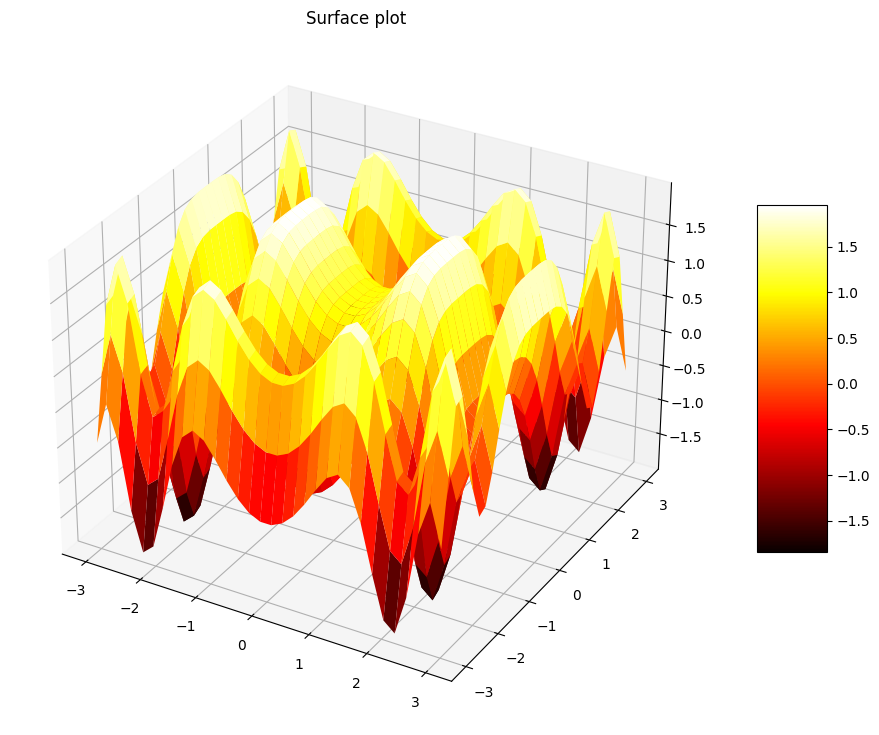

In [32]:
from mpl_toolkits import mplot3d 
import numpy as np 
import matplotlib.pyplot as plt 
x = np.outer(np.linspace(-3, 3, 32), np.ones(32)) 
y = x.copy().T 
z = (np.sin(x **2) + np.cos(y **2) ) 
fig = plt.figure(figsize =(14, 9)) 
ax = plt.axes(projection ='3d') 
my_cmap = plt.get_cmap('hot') 
surf = ax.plot_surface(x, y, z, 
                       cmap = my_cmap, 
                       edgecolor ='none') 
  
fig.colorbar(surf, ax = ax, 
             shrink = 0.5, aspect = 5) 
  
ax.set_title('Surface plot') 
plt.show() 

In [33]:
'''
#################################### Expand Grid
def expand_grid(data_dict):
   rows = itertools.product(*data_dict.values())
   return pd.DataFrame.from_records(rows, columns=data_dict.keys())

df_out = pd.DataFrame(expand_grid({'numero_iteracoes': range(11),
                                   'numero_formigas':  range(11),
                                 }))

df_out['numero_iteracoes'] = df_out['numero_iteracoes'] / 10
df_out['numero_formigas'] = df_out['numero_formigas'] / 10

#################################### Metrica Mista Realizada
dfe = df_plot_easy_n.copy()

dfe['numero_iteracoes'] = round(dfe['numero_iteracoes']/10,1)
dfe['numero_formigas']  = round(dfe['numero_formigas']/10,1)

dfe = dfe.groupby(['numero_iteracoes','numero_formigas']).metrica_mista_2.mean().reset_index()

df_out = df_out.merge(dfe, on = ['numero_iteracoes','numero_formigas'], how = 'left').fillna(0)

print(dfe.metrica_mista_2.sum())
print(df_out.metrica_mista_2.sum())

df2 = df_out.pivot_table(index=['numero_iteracoes'], columns='numero_formigas', values='metrica_mista_2').reset_index()
df2 = df2.drop(columns='numero_iteracoes')
print(df2.shape)
df2.tail()


####################################### Plot 
x = np.outer(np.linspace(0, 1, 11), np.ones(11)) 
y = x.copy().T 
z = np.array([np.array(l) for l in df2.values.tolist()])
fig = plt.figure(figsize =(14, 9)) 
ax = plt.axes(projection ='3d') 
my_cmap = plt.get_cmap('Oranges') 
surf = ax.plot_surface(x, y, z, 
                       cmap = my_cmap, 
                       edgecolor ='none') 
  
fig.colorbar(surf, ax = ax, 
             shrink = 0.5, aspect = 5) 
  
ax.set_title('Surface plot') 
plt.show() 
'''

"\n#################################### Expand Grid\ndef expand_grid(data_dict):\n   rows = itertools.product(*data_dict.values())\n   return pd.DataFrame.from_records(rows, columns=data_dict.keys())\n\ndf_out = pd.DataFrame(expand_grid({'numero_iteracoes': range(11),\n                                   'numero_formigas':  range(11),\n                                 }))\n\ndf_out['numero_iteracoes'] = df_out['numero_iteracoes'] / 10\ndf_out['numero_formigas'] = df_out['numero_formigas'] / 10\n\n#################################### Metrica Mista Realizada\ndfe = df_plot_easy_n.copy()\n\ndfe['numero_iteracoes'] = round(dfe['numero_iteracoes']/10,1)\ndfe['numero_formigas']  = round(dfe['numero_formigas']/10,1)\n\ndfe = dfe.groupby(['numero_iteracoes','numero_formigas']).metrica_mista_2.mean().reset_index()\n\ndf_out = df_out.merge(dfe, on = ['numero_iteracoes','numero_formigas'], how = 'left').fillna(0)\n\nprint(dfe.metrica_mista_2.sum())\nprint(df_out.metrica_mista_2.sum())\n\ndf2 = df_